<a href="https://colab.research.google.com/github/9-coding/ComputerVision_TeamProject/blob/main/ActiveLearning2/ActiveLearning2_modelCompare_res50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

import os
# 각자 환경에서 이 부분만 변경하여 사용하면 됩니다.
os.chdir('/content/gdrive/MyDrive/CUB_200_2011_repackage_class50')
print(os.getcwd())



Mounted at /content/gdrive/
/content/gdrive/MyDrive/CUB_200_2011_repackage_class50


In [ ]:
# !pip uninstall wandb

In [ ]:
!pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 21.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.9/243.9 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.2 MB/s eta 0:00:00


In [ ]:
!wandb login f9fc6c65de4904021a59f4c8c60b90961f6ec1fb

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
import time
import torch
import torchvision.transforms as transforms
import torchvision.models as models
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, ConcatDataset
from PIL import Image
import random

## wandb ###
import wandb
wandb.init(project='ActiveLearning2_modelCompare')

def set_seed(seed: int = 42) -> None:
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    # When running on the CuDNN backend, two further options must be set
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    # Set a fixed value for the hash seed
    os.environ["PYTHONHASHSEED"] = str(seed)
    print(f"Random seed set as {seed}")

set_seed(42)


### GPU Setting ###
USE_CUDA = torch.cuda.is_available()
DEVICE = torch.device("cuda" if USE_CUDA else "cpu")
print(DEVICE)

### Custom Dataset ###
class CUB2011(Dataset):
    def __init__(self, transform, mode='train'):
        self.transform = transform
        self.mode = mode
        self.image_folder = os.listdir(f'./datasets/{mode}')

    def __len__(self):
        return len(self.image_folder)

    def __getitem__(self, idx):
        img_path = self.image_folder[idx]
        img = Image.open(os.path.join('./datasets', self.mode, img_path)).convert('RGB')
        img = self.transform(img)
        label = int(img_path.split('_')[-1].split('.')[0])
        return (img, label)

wandb: Currently logged in as: kdy1021 (computervisionactivelearning). Use `wandb login --relogin` to force relogin


Random seed set as 42
cuda


In [ ]:
### Data Augmentation ###
def transforms_func(transform):
  return transforms.Compose([
    transforms.Resize((448, 448)),
    transform,
    transforms.ToTensor(),
])

def transforms_resize_func(resize):
  return transforms.Compose([
    resize,
    transforms.ToTensor(),
])

ROTATION_DEGREE = 30
zoom_scale = (0.8, 1.2)
transforms_rotation = transforms_func(transforms.RandomRotation(degrees=ROTATION_DEGREE))
transforms_horizontal_flip = transforms_func(transforms.RandomHorizontalFlip(p=1.0))
transforms_zoom = transforms_func(transforms.RandomResizedCrop(448, scale=zoom_scale))

transforms_train_with_augmentation = transforms_resize_func(transforms.Resize((448, 448)))
transforms_train_without_augmentation = transforms_resize_func(transforms.Resize((448, 448)))
transforms_valtest = transforms_resize_func(transforms.Resize((448, 448)))
transforms_random_resized_crop = transforms_resize_func(transforms.RandomResizedCrop(448, scale=(0.8, 1.0)))

In [ ]:
BATCH_SIZE = 32
EPOCH = 20
lr = 0.1

train_set_without_augmentation = CUB2011(mode='train', transform=transforms_train_without_augmentation)
train_set_with_augmentation = CUB2011(mode='train', transform=transforms_train_with_augmentation)

train_set_rotation = CUB2011(mode='train', transform=transforms_rotation)
train_set_horizontal_flip = CUB2011(mode='train', transform=transforms_horizontal_flip)
train_set_randomcrop =  CUB2011(mode='train', transform=transforms_random_resized_crop)
train_set_zoom = CUB2011(mode='train', transform=transforms_zoom)

combined_train_set = ConcatDataset([train_set_with_augmentation, train_set_rotation, train_set_horizontal_flip, train_set_zoom, train_set_randomcrop])

val_set = CUB2011(mode='valid', transform=transforms_valtest)
test_set = CUB2011(mode='test', transform=transforms_valtest)

train_loader_with_augmentation = DataLoader(combined_train_set, batch_size=BATCH_SIZE, shuffle=True)
train_loader_without_augmentation = DataLoader(train_set_without_augmentation, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_set, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
import torchsummary

### Model / Optimizer ###
model_with_augmentation = models.resnet50(pretrained=True)
model_without_augmentation = models.resnet50(pretrained=True)

num_features = model_with_augmentation.fc.in_features

# Adjusting for augmentation
model_with_augmentation.fc = nn.Linear(num_features, 50)
model_with_augmentation = model_with_augmentation.to(DEVICE)
optimizer_with_augmentation = optim.SGD(model_with_augmentation.parameters(), lr=lr)

# Adjusting without augmentation
model_without_augmentation.fc = nn.Linear(num_features, 50)
model_without_augmentation = model_without_augmentation.to(DEVICE)
optimizer_without_augmentation = optim.SGD(model_without_augmentation.parameters(), lr=lr)

print("resnet50")
print(torchsummary.summary(model_with_augmentation, (3, 448, 448)))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:02<00:00, 34.5MB/s]


resnet50
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           9,408
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
         MaxPool2d-4         [-1, 64, 112, 112]               0
            Conv2d-5         [-1, 64, 112, 112]           4,096
       BatchNorm2d-6         [-1, 64, 112, 112]             128
              ReLU-7         [-1, 64, 112, 112]               0
            Conv2d-8         [-1, 64, 112, 112]          36,864
       BatchNorm2d-9         [-1, 64, 112, 112]             128
             ReLU-10         [-1, 64, 112, 112]               0
           Conv2d-11        [-1, 256, 112, 112]          16,384
      BatchNorm2d-12        [-1, 256, 112, 112]             512
           Conv2d-13        [-1, 256, 112, 112]          16,384
      BatchNorm2d-14        [-

In [ ]:
### Train/Evaluation ###
def train(model, train_loader, optimizer, epoch):
    model.train()
    for i, (image, target) in enumerate(train_loader):
        image, target = image.to(DEVICE), target.to(DEVICE)
        output = model(image)
        optimizer.zero_grad()
        train_loss = F.cross_entropy(output, target).to(DEVICE)
        train_loss.backward()
        optimizer.step()

        if i % 30 == 0:
            print(f'Train Epoch {epoch} [{i}/{len(train_loader)}]\tLoss: {train_loss.item():.6f}')
    return train_loss

def evaluate(model, val_loader):
    model.eval()
    eval_loss = 0
    correct = 0
    with torch.no_grad():
        for i, (image, target) in enumerate(val_loader):
            image, target = image.to(DEVICE), target.to(DEVICE)
            output = model(image)
            eval_loss += F.cross_entropy(output, target, reduction='sum').item()
            pred = output.max(1, keepdim=True)[1]
            correct += pred.eq(target.view_as(pred)).sum().item()
        eval_loss /= len(val_loader.dataset)
        eval_accuracy = 100 * correct / len(val_loader.dataset)
        return eval_loss, eval_accuracy

Train Epoch 0 [0/369]	Loss: 4.045447
Train Epoch 0 [30/369]	Loss: 2.578201
Train Epoch 0 [60/369]	Loss: 1.159205
Train Epoch 0 [90/369]	Loss: 1.058383
Train Epoch 0 [120/369]	Loss: 0.737429
Train Epoch 0 [150/369]	Loss: 0.410569
Train Epoch 0 [180/369]	Loss: 0.297318
Train Epoch 0 [210/369]	Loss: 0.336158
Train Epoch 0 [240/369]	Loss: 0.141351
Train Epoch 0 [270/369]	Loss: 0.262265
Train Epoch 0 [300/369]	Loss: 0.162601
Train Epoch 0 [330/369]	Loss: 0.194952
Train Epoch 0 [360/369]	Loss: 0.033449


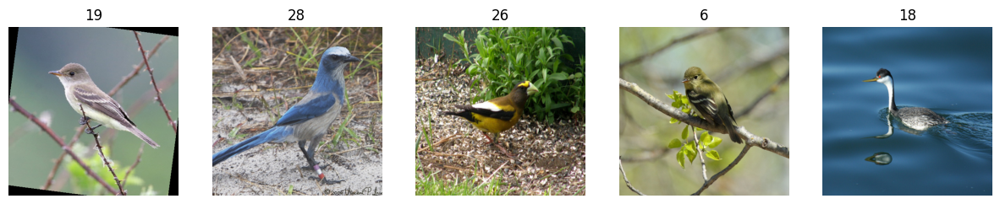

Train Epoch 0 [0/74]	Loss: 3.904366
Train Epoch 0 [30/74]	Loss: 2.660322
Train Epoch 0 [60/74]	Loss: 1.140630
Epoch 0
With Augmentation - Train Loss: 0.1251, Validation Loss: 0.6828, Validation Accuracy: 81.42%
Without Augmentation - Train Loss: 1.0772, Validation Loss: 1.9405, Validation Accuracy: 43.24%

Train Epoch 1 [0/369]	Loss: 0.066223
Train Epoch 1 [30/369]	Loss: 0.064325
Train Epoch 1 [60/369]	Loss: 0.027232
Train Epoch 1 [90/369]	Loss: 0.117353
Train Epoch 1 [120/369]	Loss: 0.199181
Train Epoch 1 [150/369]	Loss: 0.013843
Train Epoch 1 [180/369]	Loss: 0.022212
Train Epoch 1 [210/369]	Loss: 0.077781
Train Epoch 1 [240/369]	Loss: 0.066305
Train Epoch 1 [270/369]	Loss: 0.026757
Train Epoch 1 [300/369]	Loss: 0.017815
Train Epoch 1 [330/369]	Loss: 0.062645
Train Epoch 1 [360/369]	Loss: 0.042848


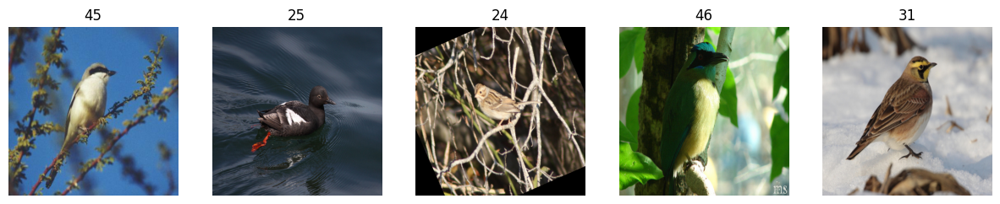

Train Epoch 1 [0/74]	Loss: 0.947546
Train Epoch 1 [30/74]	Loss: 0.512960
Train Epoch 1 [60/74]	Loss: 0.429498
Epoch 1
With Augmentation - Train Loss: 0.0187, Validation Loss: 0.3920, Validation Accuracy: 90.88%
Without Augmentation - Train Loss: 0.5582, Validation Loss: 1.7248, Validation Accuracy: 48.31%

Train Epoch 2 [0/369]	Loss: 0.017816
Train Epoch 2 [30/369]	Loss: 0.019077
Train Epoch 2 [60/369]	Loss: 0.016786
Train Epoch 2 [90/369]	Loss: 0.011418
Train Epoch 2 [120/369]	Loss: 0.005788
Train Epoch 2 [150/369]	Loss: 0.004693
Train Epoch 2 [180/369]	Loss: 0.024194
Train Epoch 2 [210/369]	Loss: 0.007240
Train Epoch 2 [240/369]	Loss: 0.003920
Train Epoch 2 [270/369]	Loss: 0.003182
Train Epoch 2 [300/369]	Loss: 0.006508
Train Epoch 2 [330/369]	Loss: 0.005135
Train Epoch 2 [360/369]	Loss: 0.004085


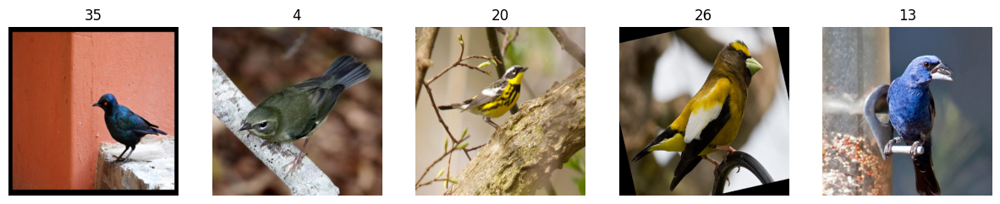

Train Epoch 2 [0/74]	Loss: 0.357927
Train Epoch 2 [30/74]	Loss: 0.101883
Train Epoch 2 [60/74]	Loss: 0.078410
Epoch 2
With Augmentation - Train Loss: 0.0063, Validation Loss: 0.2499, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.2329, Validation Loss: 1.3643, Validation Accuracy: 66.22%

Train Epoch 3 [0/369]	Loss: 0.002626
Train Epoch 3 [30/369]	Loss: 0.004523
Train Epoch 3 [60/369]	Loss: 0.008243
Train Epoch 3 [90/369]	Loss: 0.003143
Train Epoch 3 [120/369]	Loss: 0.006786
Train Epoch 3 [150/369]	Loss: 0.003921
Train Epoch 3 [180/369]	Loss: 0.005988
Train Epoch 3 [210/369]	Loss: 0.004189
Train Epoch 3 [240/369]	Loss: 0.002808
Train Epoch 3 [270/369]	Loss: 0.002800
Train Epoch 3 [300/369]	Loss: 0.002361
Train Epoch 3 [330/369]	Loss: 0.001338
Train Epoch 3 [360/369]	Loss: 0.000840


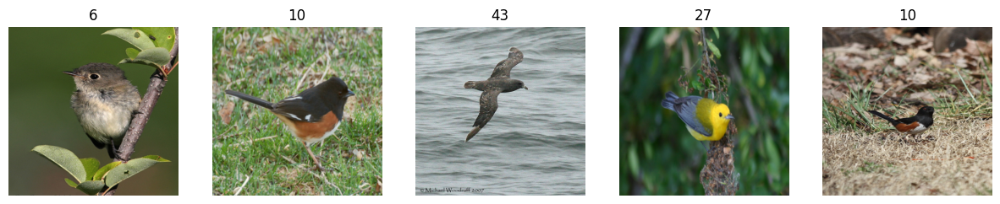

Train Epoch 3 [0/74]	Loss: 0.099716
Train Epoch 3 [30/74]	Loss: 0.058855
Train Epoch 3 [60/74]	Loss: 0.199906
Epoch 3
With Augmentation - Train Loss: 0.0016, Validation Loss: 0.2307, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.1038, Validation Loss: 0.5090, Validation Accuracy: 84.80%

Train Epoch 4 [0/369]	Loss: 0.003503
Train Epoch 4 [30/369]	Loss: 0.004119
Train Epoch 4 [60/369]	Loss: 0.002639
Train Epoch 4 [90/369]	Loss: 0.001787
Train Epoch 4 [120/369]	Loss: 0.002638
Train Epoch 4 [150/369]	Loss: 0.003218
Train Epoch 4 [180/369]	Loss: 0.002216
Train Epoch 4 [210/369]	Loss: 0.002264
Train Epoch 4 [240/369]	Loss: 0.002983
Train Epoch 4 [270/369]	Loss: 0.001331
Train Epoch 4 [300/369]	Loss: 0.001200
Train Epoch 4 [330/369]	Loss: 0.001892
Train Epoch 4 [360/369]	Loss: 0.003933


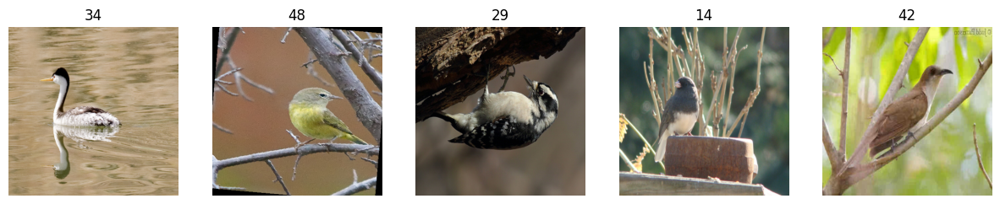

Train Epoch 4 [0/74]	Loss: 0.052194
Train Epoch 4 [30/74]	Loss: 0.030590
Train Epoch 4 [60/74]	Loss: 0.047027
Epoch 4
With Augmentation - Train Loss: 0.0021, Validation Loss: 0.3023, Validation Accuracy: 91.89%
Without Augmentation - Train Loss: 0.0873, Validation Loss: 0.3471, Validation Accuracy: 90.20%

Train Epoch 5 [0/369]	Loss: 0.000948
Train Epoch 5 [30/369]	Loss: 0.001560
Train Epoch 5 [60/369]	Loss: 0.001371
Train Epoch 5 [90/369]	Loss: 0.001676
Train Epoch 5 [120/369]	Loss: 0.001740
Train Epoch 5 [150/369]	Loss: 0.002783
Train Epoch 5 [180/369]	Loss: 0.001896
Train Epoch 5 [210/369]	Loss: 0.001032
Train Epoch 5 [240/369]	Loss: 0.001027
Train Epoch 5 [270/369]	Loss: 0.001193
Train Epoch 5 [300/369]	Loss: 0.001445
Train Epoch 5 [330/369]	Loss: 0.012582
Train Epoch 5 [360/369]	Loss: 0.001646


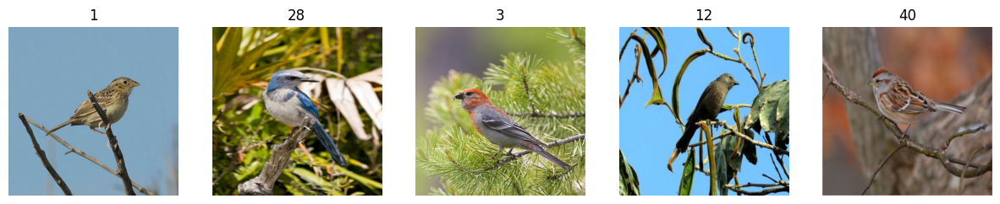

Train Epoch 5 [0/74]	Loss: 0.013934
Train Epoch 5 [30/74]	Loss: 0.007907
Train Epoch 5 [60/74]	Loss: 0.010821
Epoch 5
With Augmentation - Train Loss: 0.0043, Validation Loss: 0.2112, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.0154, Validation Loss: 0.3082, Validation Accuracy: 90.88%

Train Epoch 6 [0/369]	Loss: 0.001709
Train Epoch 6 [30/369]	Loss: 0.001827
Train Epoch 6 [60/369]	Loss: 0.001193
Train Epoch 6 [90/369]	Loss: 0.001170
Train Epoch 6 [120/369]	Loss: 0.001161
Train Epoch 6 [150/369]	Loss: 0.004405
Train Epoch 6 [180/369]	Loss: 0.001272
Train Epoch 6 [210/369]	Loss: 0.001199
Train Epoch 6 [240/369]	Loss: 0.000833
Train Epoch 6 [270/369]	Loss: 0.001271
Train Epoch 6 [300/369]	Loss: 0.008217
Train Epoch 6 [330/369]	Loss: 0.001845
Train Epoch 6 [360/369]	Loss: 0.001730


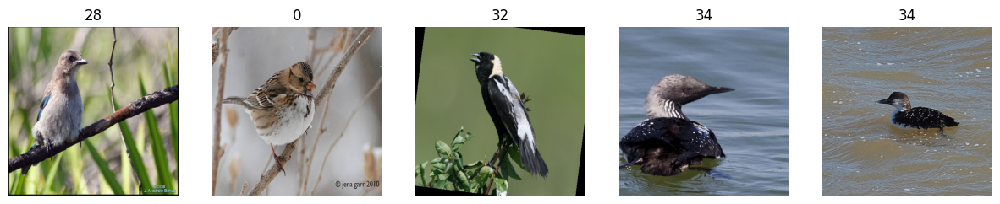

Train Epoch 6 [0/74]	Loss: 0.013509
Train Epoch 6 [30/74]	Loss: 0.015399
Train Epoch 6 [60/74]	Loss: 0.012280
Epoch 6
With Augmentation - Train Loss: 0.0027, Validation Loss: 0.2142, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.0194, Validation Loss: 0.2321, Validation Accuracy: 93.24%

Train Epoch 7 [0/369]	Loss: 0.011351
Train Epoch 7 [30/369]	Loss: 0.000975
Train Epoch 7 [60/369]	Loss: 0.000771
Train Epoch 7 [90/369]	Loss: 0.001229
Train Epoch 7 [120/369]	Loss: 0.000700
Train Epoch 7 [150/369]	Loss: 0.001025
Train Epoch 7 [180/369]	Loss: 0.000770
Train Epoch 7 [210/369]	Loss: 0.001288
Train Epoch 7 [240/369]	Loss: 0.000737
Train Epoch 7 [270/369]	Loss: 0.001842
Train Epoch 7 [300/369]	Loss: 0.001946
Train Epoch 7 [330/369]	Loss: 0.000505
Train Epoch 7 [360/369]	Loss: 0.000741


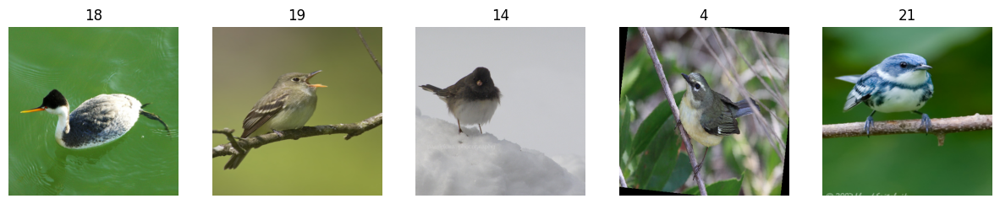

Train Epoch 7 [0/74]	Loss: 0.005230
Train Epoch 7 [30/74]	Loss: 0.004422
Train Epoch 7 [60/74]	Loss: 0.007012
Epoch 7
With Augmentation - Train Loss: 0.0004, Validation Loss: 0.2152, Validation Accuracy: 93.58%
Without Augmentation - Train Loss: 0.0104, Validation Loss: 0.2212, Validation Accuracy: 92.91%

Train Epoch 8 [0/369]	Loss: 0.000767
Train Epoch 8 [30/369]	Loss: 0.001211
Train Epoch 8 [60/369]	Loss: 0.000701
Train Epoch 8 [90/369]	Loss: 0.000819
Train Epoch 8 [120/369]	Loss: 0.000287
Train Epoch 8 [150/369]	Loss: 0.002644
Train Epoch 8 [180/369]	Loss: 0.000968
Train Epoch 8 [210/369]	Loss: 0.000500
Train Epoch 8 [240/369]	Loss: 0.001316
Train Epoch 8 [270/369]	Loss: 0.006070
Train Epoch 8 [300/369]	Loss: 0.000485
Train Epoch 8 [330/369]	Loss: 0.000791
Train Epoch 8 [360/369]	Loss: 0.001778


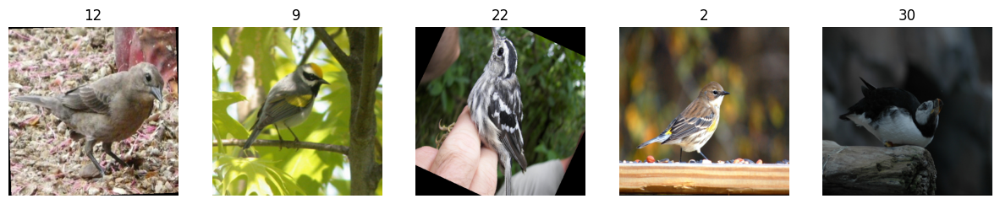

Train Epoch 8 [0/74]	Loss: 0.007600
Train Epoch 8 [30/74]	Loss: 0.005451
Train Epoch 8 [60/74]	Loss: 0.006965
Epoch 8
With Augmentation - Train Loss: 0.0019, Validation Loss: 0.2224, Validation Accuracy: 94.26%
Without Augmentation - Train Loss: 0.0089, Validation Loss: 0.2116, Validation Accuracy: 94.26%

Train Epoch 9 [0/369]	Loss: 0.000632
Train Epoch 9 [30/369]	Loss: 0.000592
Train Epoch 9 [60/369]	Loss: 0.001765
Train Epoch 9 [90/369]	Loss: 0.000632
Train Epoch 9 [120/369]	Loss: 0.000745
Train Epoch 9 [150/369]	Loss: 0.000644
Train Epoch 9 [180/369]	Loss: 0.001205
Train Epoch 9 [210/369]	Loss: 0.000637
Train Epoch 9 [240/369]	Loss: 0.000584
Train Epoch 9 [270/369]	Loss: 0.002017
Train Epoch 9 [300/369]	Loss: 0.001007
Train Epoch 9 [330/369]	Loss: 0.002706
Train Epoch 9 [360/369]	Loss: 0.001128


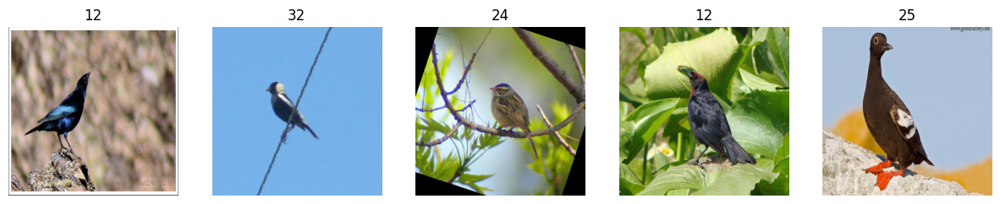

Train Epoch 9 [0/74]	Loss: 0.004634
Train Epoch 9 [30/74]	Loss: 0.004041
Train Epoch 9 [60/74]	Loss: 0.005968
Epoch 9
With Augmentation - Train Loss: 0.0004, Validation Loss: 0.2143, Validation Accuracy: 94.93%
Without Augmentation - Train Loss: 0.0053, Validation Loss: 0.2118, Validation Accuracy: 93.58%

Train Epoch 10 [0/369]	Loss: 0.000448
Train Epoch 10 [30/369]	Loss: 0.000860
Train Epoch 10 [60/369]	Loss: 0.000890
Train Epoch 10 [90/369]	Loss: 0.000575
Train Epoch 10 [120/369]	Loss: 0.000787
Train Epoch 10 [150/369]	Loss: 0.000808
Train Epoch 10 [180/369]	Loss: 0.000376
Train Epoch 10 [210/369]	Loss: 0.000891
Train Epoch 10 [240/369]	Loss: 0.000513
Train Epoch 10 [270/369]	Loss: 0.000844
Train Epoch 10 [300/369]	Loss: 0.000327
Train Epoch 10 [330/369]	Loss: 0.000564
Train Epoch 10 [360/369]	Loss: 0.001189


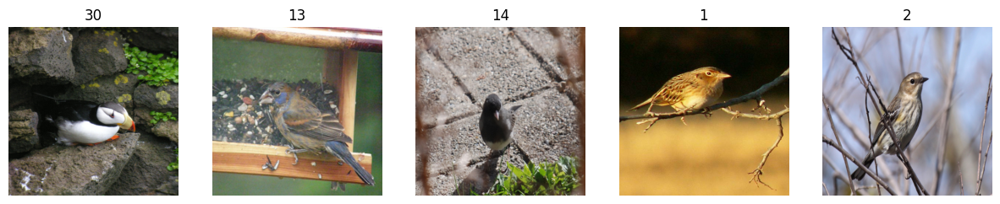

Train Epoch 10 [0/74]	Loss: 0.005679
Train Epoch 10 [30/74]	Loss: 0.007689
Train Epoch 10 [60/74]	Loss: 0.003813
Epoch 10
With Augmentation - Train Loss: 0.0010, Validation Loss: 0.2147, Validation Accuracy: 94.26%
Without Augmentation - Train Loss: 0.0053, Validation Loss: 0.2076, Validation Accuracy: 93.24%

Train Epoch 11 [0/369]	Loss: 0.000413
Train Epoch 11 [30/369]	Loss: 0.001254
Train Epoch 11 [60/369]	Loss: 0.000561
Train Epoch 11 [90/369]	Loss: 0.000256
Train Epoch 11 [120/369]	Loss: 0.000437
Train Epoch 11 [150/369]	Loss: 0.000293
Train Epoch 11 [180/369]	Loss: 0.000582
Train Epoch 11 [210/369]	Loss: 0.001039
Train Epoch 11 [240/369]	Loss: 0.000906
Train Epoch 11 [270/369]	Loss: 0.000688
Train Epoch 11 [300/369]	Loss: 0.002161
Train Epoch 11 [330/369]	Loss: 0.000548
Train Epoch 11 [360/369]	Loss: 0.000800


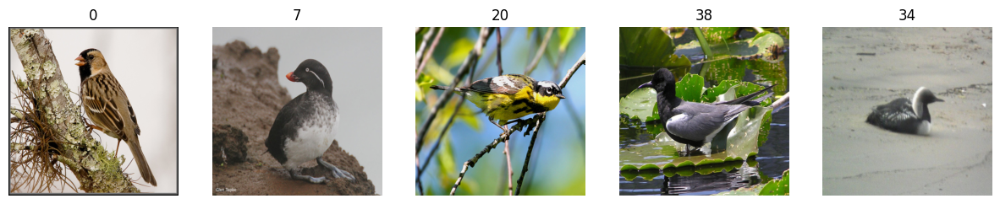

Train Epoch 11 [0/74]	Loss: 0.003514
Train Epoch 11 [30/74]	Loss: 0.003407
Train Epoch 11 [60/74]	Loss: 0.002836
Epoch 11
With Augmentation - Train Loss: 0.0009, Validation Loss: 0.2142, Validation Accuracy: 94.93%
Without Augmentation - Train Loss: 0.0043, Validation Loss: 0.2049, Validation Accuracy: 93.92%

Train Epoch 12 [0/369]	Loss: 0.000453
Train Epoch 12 [30/369]	Loss: 0.000601
Train Epoch 12 [60/369]	Loss: 0.000626
Train Epoch 12 [90/369]	Loss: 0.000790
Train Epoch 12 [120/369]	Loss: 0.000329
Train Epoch 12 [150/369]	Loss: 0.000299
Train Epoch 12 [180/369]	Loss: 0.000812
Train Epoch 12 [210/369]	Loss: 0.000627
Train Epoch 12 [240/369]	Loss: 0.000436
Train Epoch 12 [270/369]	Loss: 0.000398
Train Epoch 12 [300/369]	Loss: 0.000356
Train Epoch 12 [330/369]	Loss: 0.000221
Train Epoch 12 [360/369]	Loss: 0.000555


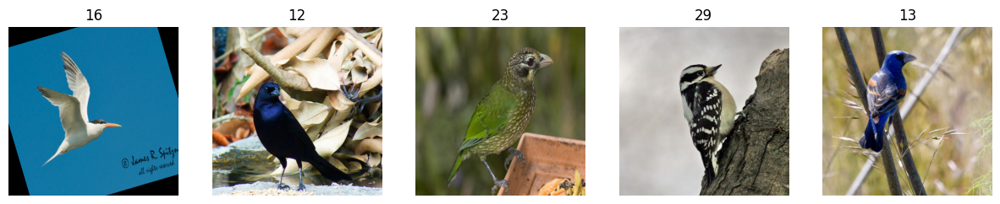

Train Epoch 12 [0/74]	Loss: 0.006407
Train Epoch 12 [30/74]	Loss: 0.002374
Train Epoch 12 [60/74]	Loss: 0.002657
Epoch 12
With Augmentation - Train Loss: 0.0034, Validation Loss: 0.2130, Validation Accuracy: 94.26%
Without Augmentation - Train Loss: 0.0023, Validation Loss: 0.2091, Validation Accuracy: 93.58%

Train Epoch 13 [0/369]	Loss: 0.002525
Train Epoch 13 [30/369]	Loss: 0.000953
Train Epoch 13 [60/369]	Loss: 0.000523
Train Epoch 13 [90/369]	Loss: 0.000894
Train Epoch 13 [120/369]	Loss: 0.000347
Train Epoch 13 [150/369]	Loss: 0.000192
Train Epoch 13 [180/369]	Loss: 0.000495
Train Epoch 13 [210/369]	Loss: 0.000530
Train Epoch 13 [240/369]	Loss: 0.002489
Train Epoch 13 [270/369]	Loss: 0.000768
Train Epoch 13 [300/369]	Loss: 0.000787
Train Epoch 13 [330/369]	Loss: 0.001301
Train Epoch 13 [360/369]	Loss: 0.001408


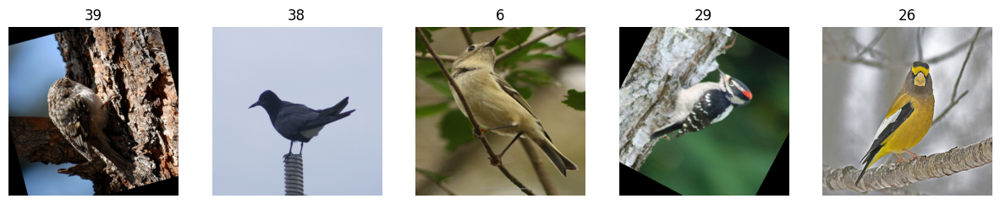

Train Epoch 13 [0/74]	Loss: 0.003644
Train Epoch 13 [30/74]	Loss: 0.004238
Train Epoch 13 [60/74]	Loss: 0.002330
Epoch 13
With Augmentation - Train Loss: 0.0022, Validation Loss: 0.2153, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.0024, Validation Loss: 0.2082, Validation Accuracy: 93.24%

Train Epoch 14 [0/369]	Loss: 0.000569
Train Epoch 14 [30/369]	Loss: 0.000550
Train Epoch 14 [60/369]	Loss: 0.000748
Train Epoch 14 [90/369]	Loss: 0.000328
Train Epoch 14 [120/369]	Loss: 0.000594
Train Epoch 14 [150/369]	Loss: 0.000459
Train Epoch 14 [180/369]	Loss: 0.000440
Train Epoch 14 [210/369]	Loss: 0.000455
Train Epoch 14 [240/369]	Loss: 0.000517
Train Epoch 14 [270/369]	Loss: 0.000185
Train Epoch 14 [300/369]	Loss: 0.002416
Train Epoch 14 [330/369]	Loss: 0.000800
Train Epoch 14 [360/369]	Loss: 0.000190


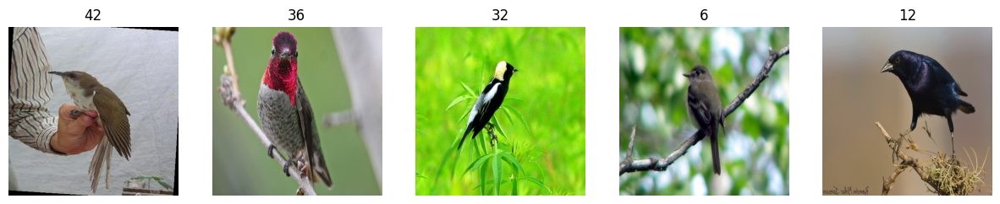

Train Epoch 14 [0/74]	Loss: 0.003164
Train Epoch 14 [30/74]	Loss: 0.004123
Train Epoch 14 [60/74]	Loss: 0.002808
Epoch 14
With Augmentation - Train Loss: 0.0004, Validation Loss: 0.2093, Validation Accuracy: 94.59%
Without Augmentation - Train Loss: 0.0103, Validation Loss: 0.2116, Validation Accuracy: 93.58%

Train Epoch 15 [0/369]	Loss: 0.000569
Train Epoch 15 [30/369]	Loss: 0.000556
Train Epoch 15 [60/369]	Loss: 0.000841
Train Epoch 15 [90/369]	Loss: 0.000414
Train Epoch 15 [120/369]	Loss: 0.000192
Train Epoch 15 [150/369]	Loss: 0.000196
Train Epoch 15 [180/369]	Loss: 0.001222
Train Epoch 15 [210/369]	Loss: 0.002175
Train Epoch 15 [240/369]	Loss: 0.000331
Train Epoch 15 [270/369]	Loss: 0.000750
Train Epoch 15 [300/369]	Loss: 0.000325
Train Epoch 15 [330/369]	Loss: 0.000266
Train Epoch 15 [360/369]	Loss: 0.000203


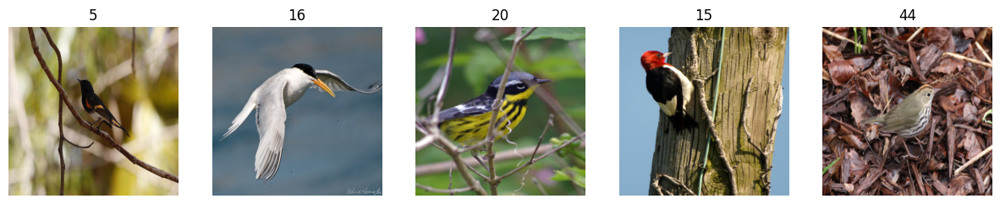

Train Epoch 15 [0/74]	Loss: 0.001701
Train Epoch 15 [30/74]	Loss: 0.002196
Train Epoch 15 [60/74]	Loss: 0.002419
Epoch 15
With Augmentation - Train Loss: 0.0009, Validation Loss: 0.2039, Validation Accuracy: 94.59%
Without Augmentation - Train Loss: 0.0052, Validation Loss: 0.2081, Validation Accuracy: 93.24%

Train Epoch 16 [0/369]	Loss: 0.000568
Train Epoch 16 [30/369]	Loss: 0.000229
Train Epoch 16 [60/369]	Loss: 0.000434
Train Epoch 16 [90/369]	Loss: 0.000246
Train Epoch 16 [120/369]	Loss: 0.000916
Train Epoch 16 [150/369]	Loss: 0.000272
Train Epoch 16 [180/369]	Loss: 0.000162
Train Epoch 16 [210/369]	Loss: 0.000430
Train Epoch 16 [240/369]	Loss: 0.000417
Train Epoch 16 [270/369]	Loss: 0.000482
Train Epoch 16 [300/369]	Loss: 0.001100
Train Epoch 16 [330/369]	Loss: 0.000381
Train Epoch 16 [360/369]	Loss: 0.000222


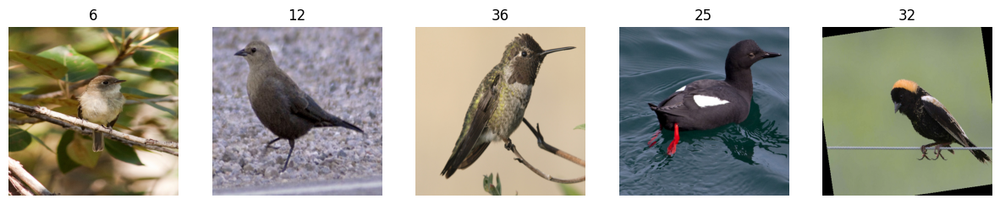

Train Epoch 16 [0/74]	Loss: 0.001915
Train Epoch 16 [30/74]	Loss: 0.003973
Train Epoch 16 [60/74]	Loss: 0.002375
Epoch 16
With Augmentation - Train Loss: 0.0023, Validation Loss: 0.2070, Validation Accuracy: 93.92%
Without Augmentation - Train Loss: 0.0038, Validation Loss: 0.2050, Validation Accuracy: 93.58%

Train Epoch 17 [0/369]	Loss: 0.000363
Train Epoch 17 [30/369]	Loss: 0.000322
Train Epoch 17 [60/369]	Loss: 0.000327
Train Epoch 17 [90/369]	Loss: 0.000715
Train Epoch 17 [120/369]	Loss: 0.000423
Train Epoch 17 [150/369]	Loss: 0.000264
Train Epoch 17 [180/369]	Loss: 0.000329
Train Epoch 17 [210/369]	Loss: 0.000226
Train Epoch 17 [240/369]	Loss: 0.000458
Train Epoch 17 [270/369]	Loss: 0.000782
Train Epoch 17 [300/369]	Loss: 0.000530
Train Epoch 17 [330/369]	Loss: 0.000431
Train Epoch 17 [360/369]	Loss: 0.000743


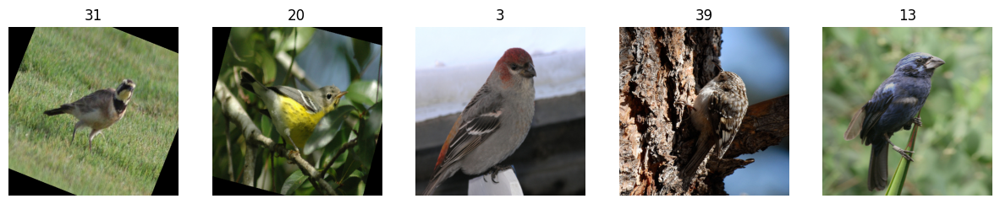

Train Epoch 17 [0/74]	Loss: 0.003424
Train Epoch 17 [30/74]	Loss: 0.002288
Train Epoch 17 [60/74]	Loss: 0.003260
Epoch 17
With Augmentation - Train Loss: 0.0015, Validation Loss: 0.2052, Validation Accuracy: 94.59%
Without Augmentation - Train Loss: 0.0024, Validation Loss: 0.2078, Validation Accuracy: 92.57%

Train Epoch 18 [0/369]	Loss: 0.001468
Train Epoch 18 [30/369]	Loss: 0.000694
Train Epoch 18 [60/369]	Loss: 0.000134
Train Epoch 18 [90/369]	Loss: 0.000370
Train Epoch 18 [120/369]	Loss: 0.000401
Train Epoch 18 [150/369]	Loss: 0.000445
Train Epoch 18 [180/369]	Loss: 0.000207
Train Epoch 18 [210/369]	Loss: 0.000138
Train Epoch 18 [240/369]	Loss: 0.000435
Train Epoch 18 [270/369]	Loss: 0.001027
Train Epoch 18 [300/369]	Loss: 0.000779
Train Epoch 18 [330/369]	Loss: 0.000254
Train Epoch 18 [360/369]	Loss: 0.000303


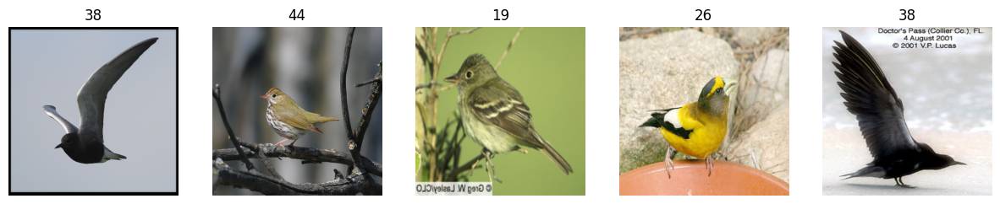

Train Epoch 18 [0/74]	Loss: 0.002274
Train Epoch 18 [30/74]	Loss: 0.002635
Train Epoch 18 [60/74]	Loss: 0.001687
Epoch 18
With Augmentation - Train Loss: 0.0008, Validation Loss: 0.2057, Validation Accuracy: 94.59%
Without Augmentation - Train Loss: 0.0050, Validation Loss: 0.2056, Validation Accuracy: 94.26%

Train Epoch 19 [0/369]	Loss: 0.000197
Train Epoch 19 [30/369]	Loss: 0.000360
Train Epoch 19 [60/369]	Loss: 0.000273
Train Epoch 19 [90/369]	Loss: 0.000341
Train Epoch 19 [120/369]	Loss: 0.000708
Train Epoch 19 [150/369]	Loss: 0.000362
Train Epoch 19 [180/369]	Loss: 0.000142
Train Epoch 19 [210/369]	Loss: 0.000675
Train Epoch 19 [240/369]	Loss: 0.000160
Train Epoch 19 [270/369]	Loss: 0.000297
Train Epoch 19 [300/369]	Loss: 0.000325
Train Epoch 19 [330/369]	Loss: 0.000235
Train Epoch 19 [360/369]	Loss: 0.000825


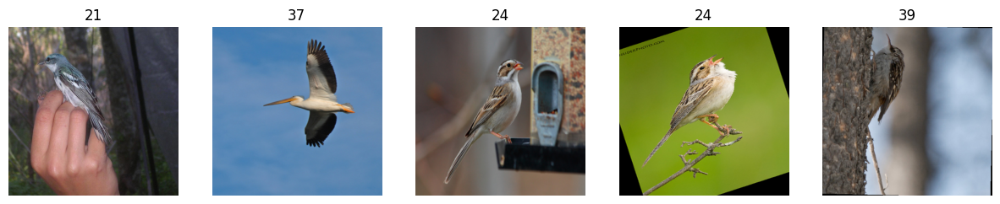

Train Epoch 19 [0/74]	Loss: 0.001487
Train Epoch 19 [30/74]	Loss: 0.005533
Train Epoch 19 [60/74]	Loss: 0.003705
Epoch 19
With Augmentation - Train Loss: 0.0006, Validation Loss: 0.1967, Validation Accuracy: 95.61%
Without Augmentation - Train Loss: 0.0027, Validation Loss: 0.2056, Validation Accuracy: 92.91%

[FINAL with Augmentation] Test Loss: 0.2704, Accuracy: 93.2886%
[FINAL without Augmentation] Test Loss: 0.2373, Accuracy: 92.2819%
Best Accuracy with Augmentation: 95.61%
Best Accuracy without Augmentation: 94.26%
Elapsed Time: 1h, 11m, 3s
time: 1h, 71m, 3s


In [ ]:
### Main ###
start = time.time()
best_with_augmentation = 0
best_without_augmentation = 0

### wandb ###
wandb.watch(model_with_augmentation, log="all")
wandb.watch(model_without_augmentation, log="all")

for epoch in range(EPOCH):
    # With Augmentation
    train_loss_with_augmentation = train(model_with_augmentation, train_loader_with_augmentation, optimizer_with_augmentation, epoch)
    val_loss_with_augmentation, val_accuracy_with_augmentation = evaluate(model_with_augmentation, val_loader)

    # Save best model
    if val_accuracy_with_augmentation > best_with_augmentation:
        best_with_augmentation = val_accuracy_with_augmentation
        torch.save(model_with_augmentation.state_dict(), "./best_model_with_augmentation.pth")

    # augmentation 적용한 이미지 보기
    dataiter = iter(train_loader_with_augmentation)
    images, labels = dataiter.__next__()
    fig, axes = plt.subplots(1, 5, figsize=(15, 5))
    for i in range(5):
      image = images[i].numpy().transpose((1, 2, 0))
      image = np.clip(image, 0, 1)
      axes[i].imshow(image)
      axes[i].set_title(labels[i].item())
      axes[i].axis('off')
    plt.show()

    # Without Augmentation
    train_loss_without_augmentation = train(model_without_augmentation, train_loader_without_augmentation, optimizer_without_augmentation, epoch)
    val_loss_without_augmentation, val_accuracy_without_augmentation = evaluate(model_without_augmentation, val_loader)

    # Logging for model without augmentation
    wandb.log({
        'train_loss_with_aug': train_loss_with_augmentation.item(),
        'val_loss_with_aug': val_loss_with_augmentation,
        'val_accuracy_with_aug': val_accuracy_with_augmentation,
        'train_loss_without_aug': train_loss_without_augmentation.item(),
        'val_loss_without_aug': val_loss_without_augmentation,
        'val_accuracy_without_aug': val_accuracy_without_augmentation
    })

    if val_accuracy_without_augmentation > best_without_augmentation:
        best_without_augmentation = val_accuracy_without_augmentation
        torch.save(model_without_augmentation.state_dict(), "./best_model_without_augmentation.pth")

    print(f'Epoch {epoch}')
    print(f"With Augmentation - Train Loss: {train_loss_with_augmentation.item():.4f}, Validation Loss: {val_loss_with_augmentation:.4f}, Validation Accuracy: {val_accuracy_with_augmentation:.2f}%")
    print(f"Without Augmentation - Train Loss: {train_loss_without_augmentation.item():.4f}, Validation Loss: {val_loss_without_augmentation:.4f}, Validation Accuracy: {val_accuracy_without_augmentation:.2f}%")
    print("")

# Test results
test_loss_with_augmentation, test_accuracy_with_augmentation = evaluate(model_with_augmentation, test_loader)
test_loss_without_augmentation, test_accuracy_without_augmentation = evaluate(model_without_augmentation, test_loader)

wandb.log({'test_accuracy_with_aug': test_accuracy_with_augmentation})

print(f'[FINAL with Augmentation] Test Loss: {test_loss_with_augmentation:.4f}, Accuracy: {test_accuracy_with_augmentation:.4f}%')
print(f'[FINAL without Augmentation] Test Loss: {test_loss_without_augmentation:.4f}, Accuracy: {test_accuracy_without_augmentation:.4f}%')

end = time.time()
elasped_time = end - start
print(f"Best Accuracy with Augmentation: {best_with_augmentation:.2f}%")
print(f"Best Accuracy without Augmentation: {best_without_augmentation:.2f}%")
print(f"Elapsed Time: {int(elasped_time/3600)}h, {int((elasped_time%3600)/60)}m, {int(elasped_time%60)}s")
print(f"time: {int (elasped_time/3600)}h, {int(elasped_time/60)}m, {int(elasped_time%60)}s")

In [ ]:
torch.save(model_with_augmentation.state_dict(), "./model_state_dict.pt")

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 50.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.4.8-py3-none-any.whl size=38244 sha256=ec4801f03333affbbe583366a30bcde136af57b5943c0b19b06ec83bdee34591
  Stored in directory: /root/.cache/pip/wheels/f8/04/36/94ff3c8a4215826a21946b34c01180817e606989fdf53f7cd6
Successfully built grad-cam


Test Loss: 0.2704, Accuracy: 93.2886%


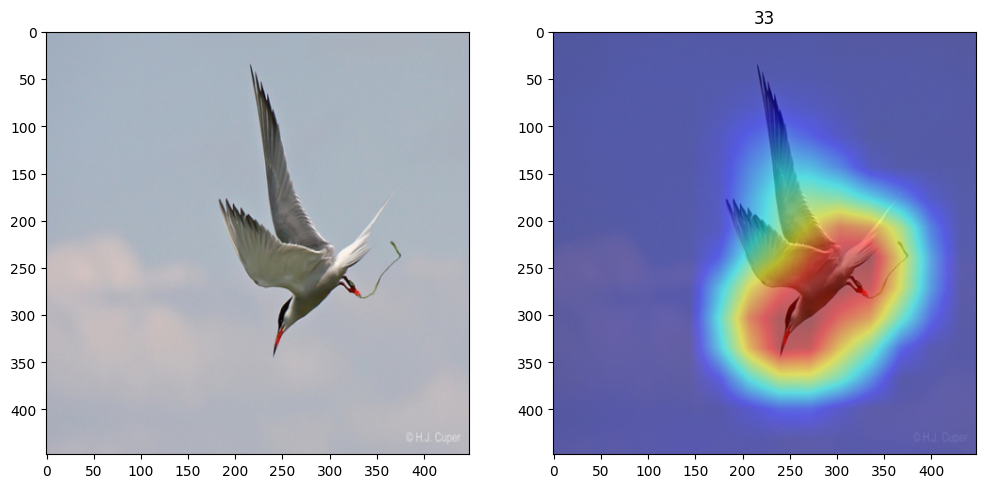

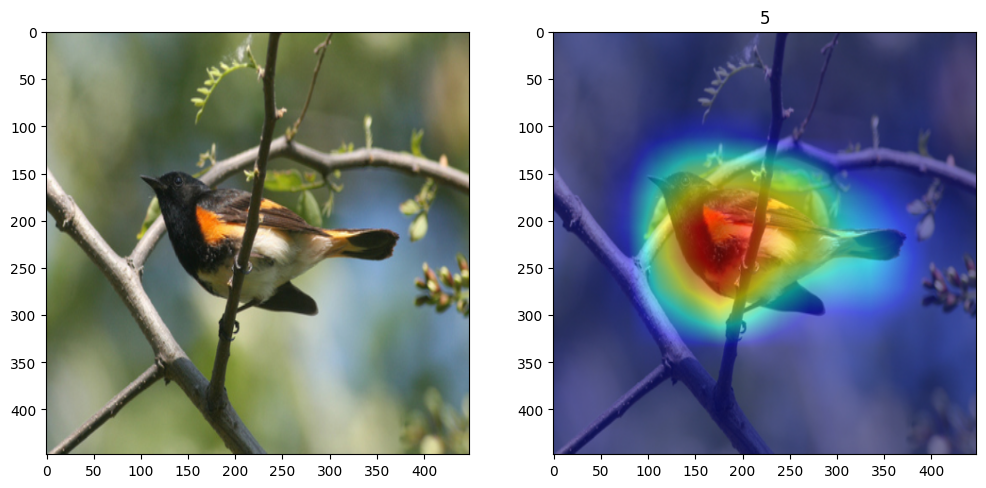

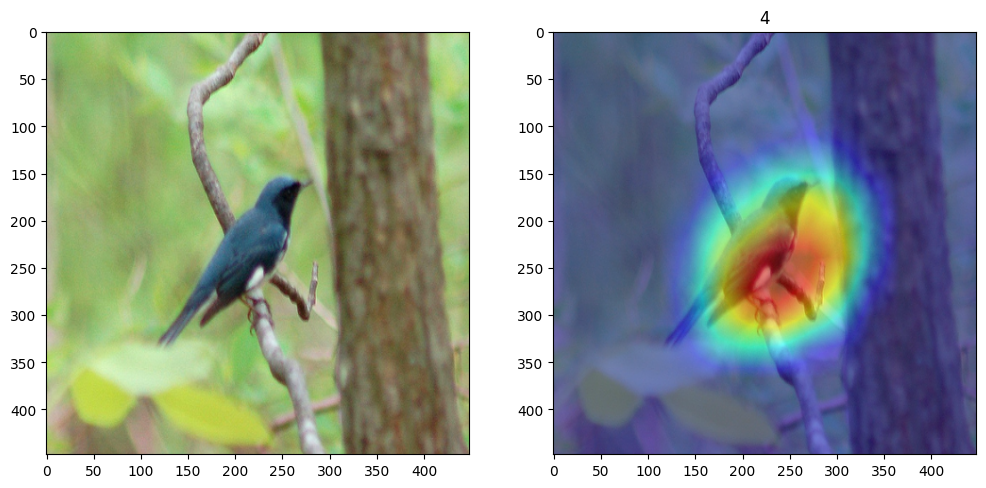

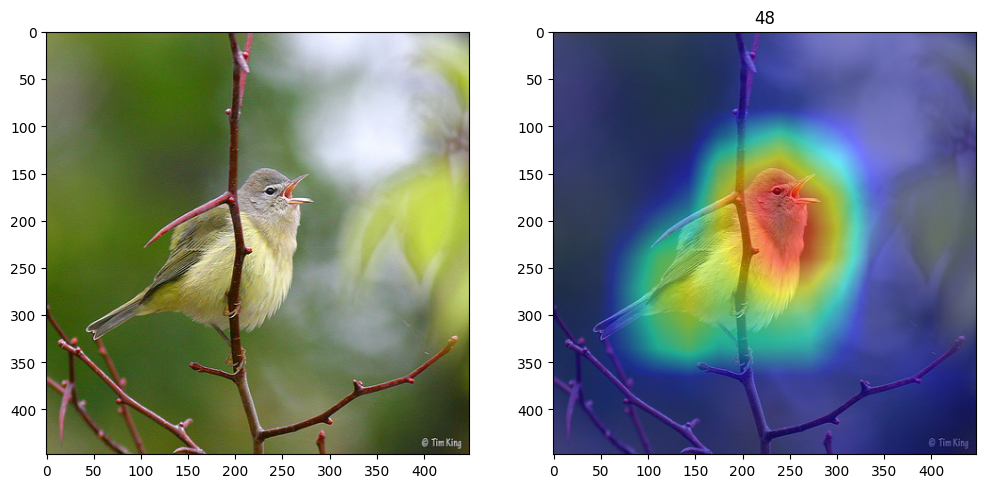

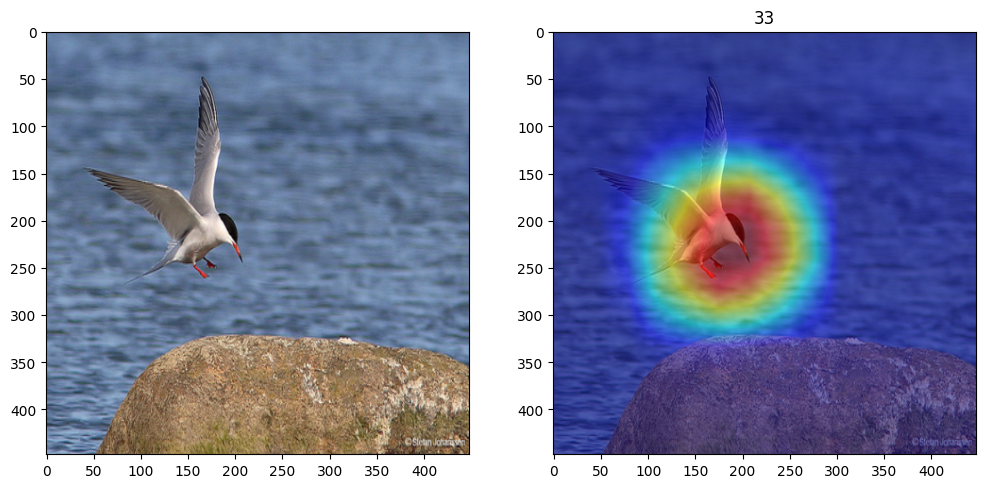

...

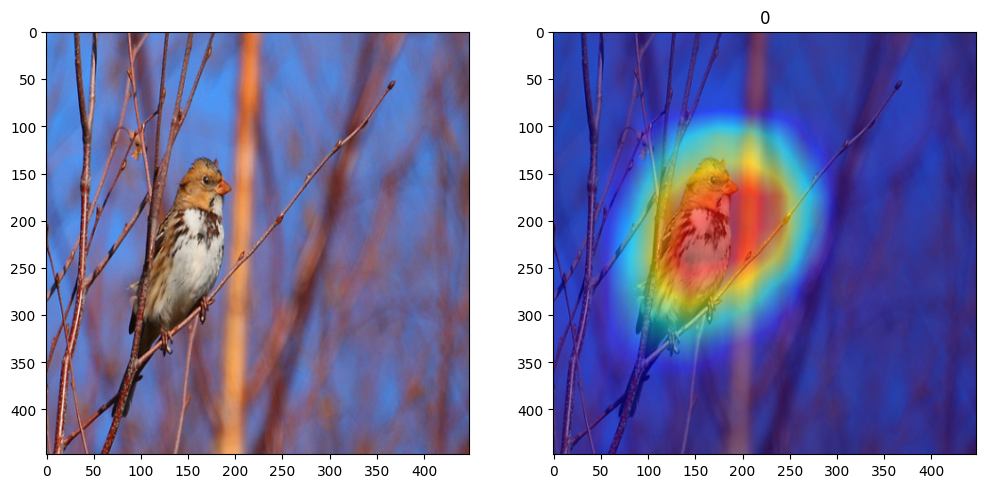

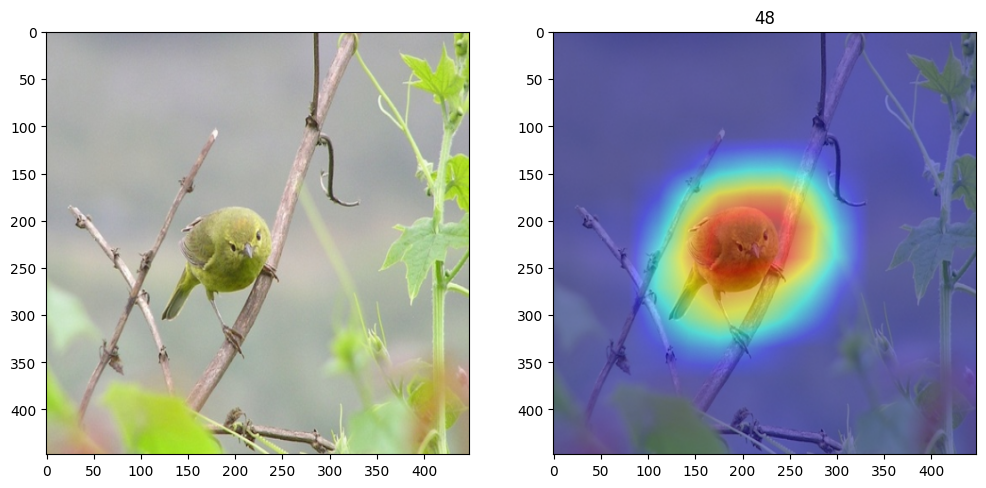

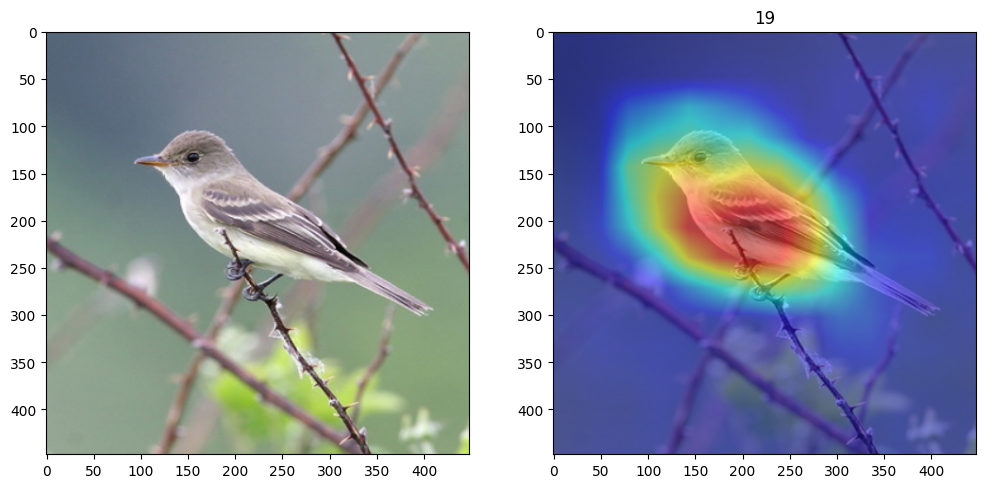

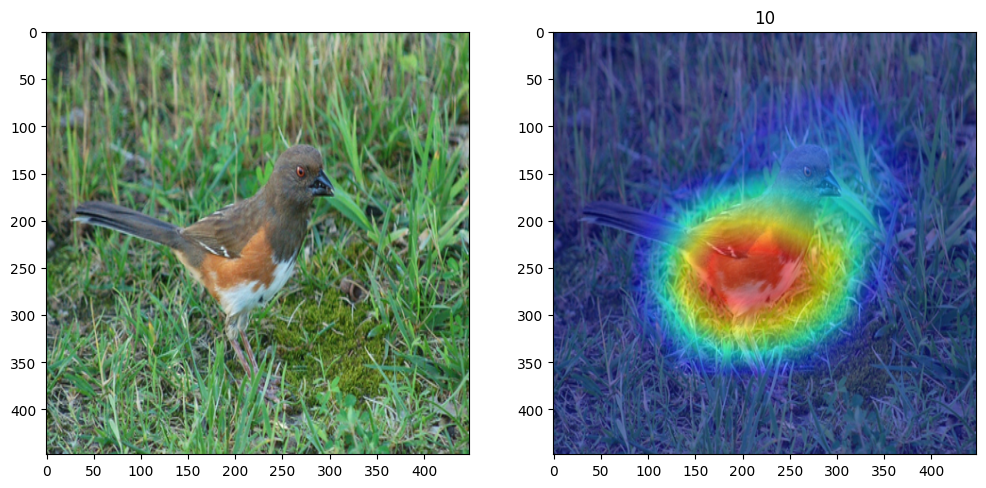

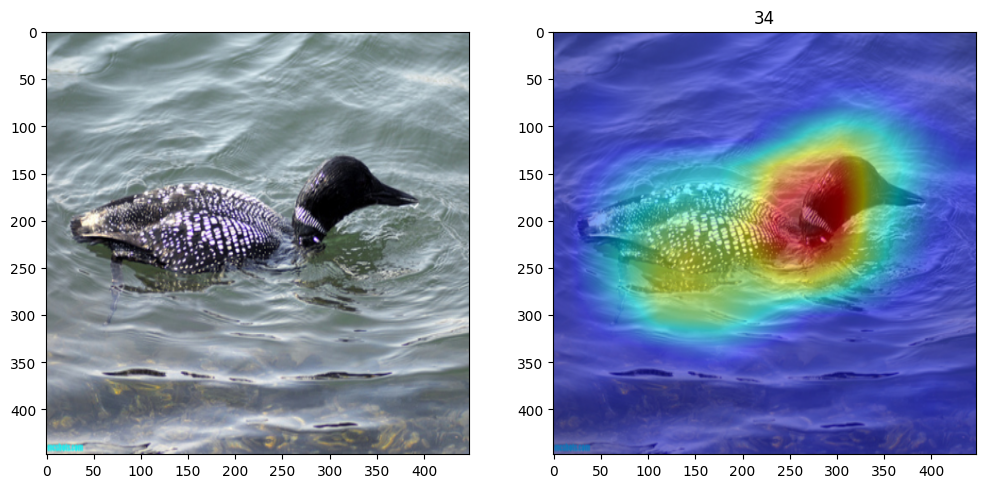

In [ ]:
import copy
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet18
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as T
from matplotlib import pyplot as plt
"""
model = model_
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 50)
model = model.to(DEVICE)
optimizer = optim.SGD(model.parameters(), lr=lr)

model.load_state_dict(torch.load("model_state_dict.pt"))
model.eval()
"""

model = model_with_augmentation
test_loss, test_accuracy = evaluate(model, test_loader)


print(f'Test Loss: {test_loss:.4f}, Accuracy: {test_accuracy:.4f}%')


def gradCAM_func(num):
  image_tensor, label = combined_train_set[num]
  transform = T.ToPILImage()
  rgb_img = transform(image_tensor)
  target_layers = [model.layer4[-1]]
  # Max min normalization
  rgb_img = (rgb_img - np.min(rgb_img)) / (np.max(rgb_img) - np.min(rgb_img))
  # Create an input tensor image for your model
  input_tensor = torchvision.transforms.functional.to_tensor(rgb_img).unsqueeze(0).float()
  # Note: input_tensor can be a batch tensor with several images!

  # Construct the CAM object once, and then re-use it on many images:
  cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)

  grayscale_cam = cam(input_tensor=input_tensor)

  # In this example grayscale_cam has only one image in the batch:
  grayscale_cam = grayscale_cam[0, :]
  visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
  Image.fromarray(visualization, 'RGB')
  fig, ax = plt.subplots(1, 2, figsize=(12, 6))

  # Display the image using imshow
  ax[0].imshow(rgb_img)
  ax[1].imshow(visualization)

  # Show the plot
  plt.title(label)
  plt.show()

  # Image.fromarray(visualization, 'RGB')

# 괄호 안에 아무 수나 넣고 테스트하면 됩니다.
for i in range(200):
  if i % 10 == 0:
    gradCAM_func(i)